# **ANÁLISIS DE VENTAS Y TENDENCIAS EN LA INDUSTRIA DE LOS VIDEOJUEGOS**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


*Laura Marcela Vásquez López*  

*Christian Bermúdez Rivas*

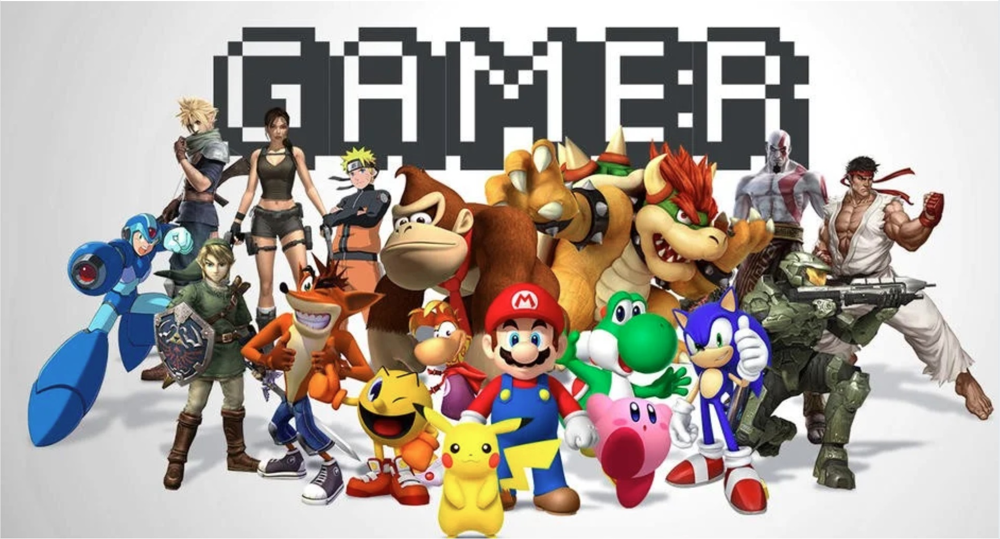

In [4]:
from IPython.display import display, Image

# Cargar y mostrar la imagen
display(Image(filename='videojuegos.jpg', width=700, height=400))


## **CONTEXTO DEL NEGOCIO**

La industria de los videojuegos ha experimentado un crecimiento exponencial
desde su inicio en la década de 1970. Con la evolución de la tecnología, las consolas, los géneros y la distribución digital han transformado la manera en que los jugadores interactúan con los videojuegos. Desde los arcade hasta los juegos en la nube, la industria ha demostrado su capacidad de adaptación y expansión, convirtiéndose en un sector multimillonario que rivaliza con otras formas de entretenimiento como el cine y la música. El análisis de las ventas y tendencias dentro de esta industria permite comprender los factores importantes que impulsan su desarrollo y cómo los jugadores han influenciado su evolución.


## **PREGUNTAS DEL NEGOCIO**

A pesar del crecimiento sostenido de la industria, no todas las plataformas ni géneros han tenido el mismo desempeño. Comprender qué consolas han dominado el mercado, cuáles son los videojuegos más vendidos y cuál es el impacto del top 10 en las ventas totales, puede proporcionar información valiosa para desarrolladores, inversionistas y analistas de mercado. Además, evaluar las tendencias de ventas en regiones clave como Japón, Estados Unidos y Europa, así como el comportamiento de géneros específicos, puede ayudar a prever cambios en la industria. Para resolver lo anterior es necesario responder a las siguientes preguntas:

* ¿Cual es el top 10 de videojuegos basado en el total de ventas?
* ¿Cuánto fué la suma aportada por estos 10 juegos, versus el resto de los juegos?
* Porcentualmente hablando ¿cuánto es el aporte del top 10 de juegos elegido versus el resto de los juegos?
* ¿Cómo se encuentran porcentualmente divididas el total de ventas?
* ¿Cuál es la tendencia de las ventas en Japón, Estados Unidos y Europa?
* ¿Cuál es la tendencia para los géneros de Action, Role-Playing, Strategy and Misc?
* ¿Cómo es la distribución porcentual de las ventas para los años 2000, 2005, 2010 y 2015?
* ¿Qué género aportó más porcentualmente en cada año y por cuánto valor?
* Compare 3 géneros en un rango de 4 años entre el 2000 al 2010 e indique ¿dónde presentó cada género mayor auge o ventas?
* ¿Cómo es la distribución percentil? ¿dónde presenta mayor agrupamiento de los datos?
* En una vista superpuesta indique o compare los scores para el género escogido. ¿Hay cercanía entre las valoraciones de los usuarios y la de los críticos?
* ¿Cuál es el valor del score aproximadamente donde un videojuego alcanzó el mayor número de ventas?
* ¿Cuál es la distribución de la correlación para el género escogido?
* ¿Qué relación existe entre los scores de los jugadores y de la crítica para el género escogido?
* ¿Qué plataforma obtuvo la mayor cantidad de ventas?
* ¿Cuántos juegos por año se lanzaron por plataforma?
* ¿Cuál es el juego más valorado por la crítica? ¿Cuál por los usuarios?
* ¿Cuántos juegos tiene cada productor o publicador de videojuegos?

## **CONJUNTO DE DATOS**

El conjunto de datos utilizado en este análisis contiene información detallada sobre las ventas de videojuegos a lo largo del tiempo, incluyendo datos de distintas consolas, géneros, ventas regionales y puntuaciones de crítica y usuarios. Este dataset permite explorar las ventas globales y regionales, así como analizar la relación entre la popularidad de un videojuego y su recepción por parte de la comunidad. A través de este estudio, se busca proporcionar una visión integral de las tendencias de la industria, facilitando la identificación de patrones y la toma de decisiones basada en datos.

## **SOLUCIONES BASADAS EN VISUALIZACIÓN**

Para responder a las dudas relacionadas con el negocio, se llevarán a cabo las siguientes visualizaciones.

In [103]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')


datos = pd.read_excel('games_sales_data_PBI.xlsx', sheet_name='games_sales_data_PBI')
datos.head()

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
0,Wii Sports,Wii,2006.0,Sports,Nintendo,41.36,28.96,3.77,8.45,82.53,76.0,51.0,8,322.0,Nintendo,E
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,NaN,NaN,NaN,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008.0,Racing,Nintendo,15.68,12.76,3.79,3.29,35.52,82.0,73.0,8.3,709.0,Nintendo,E
3,Wii Sports Resort,Wii,2009.0,Sports,Nintendo,15.61,10.93,3.28,2.95,32.77,80.0,73.0,8,192.0,Nintendo,E
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,NaN,NaN,NaN,NaN,NaN,NaN


## Ejercicio 1

* ¿Cual es el top 10 de videojuegos basado en el total de ventas?
* ¿Cuánto fué la suma aportada por estos 10 juegos, versus el resto de los juegos?
* Porcentualmente hablando ¿cuánto es el aporte del top 10 de juegos elegido versus el resto de los juegos?

Dropdown(description='Seleccionar Año:', index=11, layout=Layout(align_self='center', margin='20px 20px 10px 0…

FloatText(value=21.57, description='Ventas Top 10 [M USD]:', disabled=True, layout=Layout(align_self='center',…

FloatText(value=10.66, description='Ventas Otros [M USD]:', disabled=True, layout=Layout(align_self='center', …

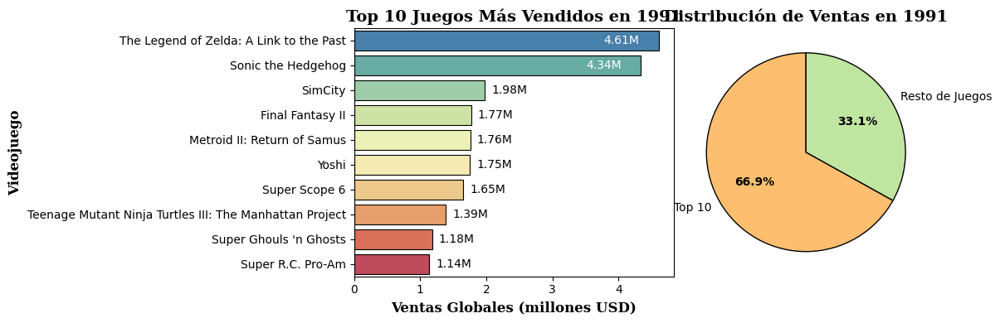

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import mplcursors
import ipywidgets as widgets
from IPython.display import display, clear_output

# Convertir la columna 'Year_of_Release' a tipo entero y eliminar valores NaN
df = datos.dropna(subset=['Year_of_Release']).copy()
df['Year_of_Release'] = df['Year_of_Release'].astype(int)

# Filtrar las columnas necesarias
df1 = df[['Name', 'Year_of_Release', 'Global_Sales']].copy()

# Obtener lista de años únicos ordenados
years = sorted(df1["Year_of_Release"].unique())

# Widget para seleccionar el año
year_selector = widgets.Dropdown(
    options=years,
    value=years[0],
    description='Seleccionar Año:',
    disabled=False,
    style={'description_width': 'auto'},
    layout=widgets.Layout(
        margin='20px 20px 10px 0px',
        width='250px',
        align_self='center'
    )
)

# Widget de texto 1
ventas_top10 = widgets.FloatText(
    value=0,
    description="Ventas Top 10 [M USD]:",
    disabled=True,
    style={'description_width': 'auto'},
    layout=widgets.Layout(
        margin='20px 20px 10px 0px',
        width='250px',
        align_self='center'
    )
)

# Widget de texto 2
ventas_resto = widgets.FloatText(
    value=0,
    description="Ventas Otros [M USD]:",
    disabled=True,
    style={'description_width': 'auto'},
    layout=widgets.Layout(
        margin='20px 20px 10px 0px',
        width='250px',
        align_self='center'
    )
)

# Función para actualizar la gráfica de barras y agregar subplot con pie chart
def actualizar_grafica(año):
    df_filtrado = df1[df1["Year_of_Release"] == año].copy()

    # Obtener el Top 10 juegos más vendidos, asegurando orden descendente
    top_10 = df_filtrado.nlargest(10, "Global_Sales").sort_values(by="Global_Sales", ascending=True)

    # Sumar ventas del Top 10 y del resto de juegos
    total_top10 = round(top_10["Global_Sales"].sum(), 2)
    total_resto = round(df_filtrado["Global_Sales"].sum() - total_top10, 2)

    # Actualizar los cuadros de texto con las ventas
    ventas_top10.value = total_top10
    ventas_resto.value = total_resto

    # Limpiar la salida para evitar múltiples gráficos
    clear_output(wait=True)

    # Volver a mostrar los widgets para evitar que desaparezcan
    display(year_selector, ventas_top10, ventas_resto)

    # Crear una figura con dos subgráficos
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))  # Gráfica de barras a la izquierda, pie chart a la derecha

    # Gráfica de Barras (Top 10 más vendidos)
    bars = sns.barplot(
        x=top_10["Global_Sales"],
        y=top_10["Name"],
        hue=top_10["Name"],
        dodge=False,
        legend=False,
        palette="Spectral",
        errorbar=None,
        ax=ax1
    )

    # Agregar borde negro a cada barra
    for bar in bars.patches:
        bar.set_edgecolor("black")
        bar.set_linewidth(0.8)

    # Ajustar el espaciado entre barras
    ax1.set_ylim(-0.5, len(top_10) - 0.5)

    # Agregar etiquetas dentro de la barra si es lo suficientemente larga
    for i, value in enumerate(top_10["Global_Sales"]):
        text_x = value - 0.3 if value > 0.6 * max(top_10["Global_Sales"]) else value + 0.1
        color = "white" if text_x == (value - 0.3) else "black"
        ax1.text(text_x, i, f"{value:.2f}M", va='center', ha="right" if text_x < value else "left", color=color)

    # Configurar títulos para la gráfica de barras
    ax1.set_title(f"Top 10 Juegos Más Vendidos en {año}", fontsize=14, fontweight='bold', fontfamily='serif')
    ax1.set_xlabel("Ventas Globales (millones USD)", fontsize=12, fontweight='bold', fontfamily='serif')
    ax1.set_ylabel("Videojuego", fontsize=12, fontweight='bold', fontfamily='serif')

    # Seleccionar la paleta de colores de Seaborn
    palette_name = "Spectral"
    num_colors = 2

    # Extraer los colores de la paleta de seleccionada
    colors = sns.color_palette(palette_name, num_colors)

    # Gráfica de Pie Chart
    datos_pie = pd.DataFrame({
        'Categoría': ['Top 10', 'Resto de Juegos'],
        'Ventas': [total_top10, total_resto]
    })

    wedges, texts, autotexts = ax2.pie(
        datos_pie["Ventas"],
        labels=datos_pie["Categoría"],
        autopct='%1.1f%%',
        colors=colors,
        startangle=90,
        wedgeprops={'edgecolor': 'black'}  # Bordes en las secciones
    )

    # Personalizar etiquetas de porcentaje en la gráfica de pastel
    for text in texts:
        text.set_fontsize(10)  # Tamaño del texto de la categoría
        text.set_fontweight('normal')

    for autotext in autotexts:
        autotext.set_fontsize(10)  # Tamaño del porcentaje
        autotext.set_fontweight('bold')  # Negrita

    ax2.set_title(f"Distribución de Ventas en {año}", fontsize=14, fontweight='bold', fontfamily='serif')

    # Hacer la gráfica interactiva con mplcursors solo en barras
    cursor = mplcursors.cursor(ax1.patches, hover=True)
    cursor.connect("add", lambda sel: sel.annotation.set_text(f"{sel.target[0]:.2f}M"))

    # Ajustar el diseño y mostrar la gráfica
    plt.tight_layout()
    plt.show()

# Mostrar selector de años y cuadros de texto con las ventas
display(year_selector, ventas_top10, ventas_resto)

# Mostrar la gráfica inicial con el primer año seleccionado
actualizar_grafica(year_selector.value)

# Conectar el widget al cambio de año
def on_change(change):
    actualizar_grafica(change["new"])

year_selector.observe(on_change, names='value')


A partir de las visualizaciones anteriores, se puede inferir el comportamiento de las ventas de los videojuegos más exitosos en función del año de interés. Asimismo, el análisis a lo largo del tiempo permite identificar cómo ha evolucionado la industria en términos de la cantidad de títulos lanzados al mercado.

Por ejemplo, en 1980, el Top 10 de videojuegos concentraba el 100% de las ventas, lo que evidencia un mercado aún reducido y dominado por un número limitado de títulos. Sin embargo, con el paso del tiempo, se observa una creciente diversificación en la oferta de videojuegos. Para 1990, el incremento en la variedad de títulos es notable, aunque el Top 10 todavía representaba aproximadamente el 90% de las ventas globales, con Super Mario consolidándose como el videojuego más vendido de ese año.

En contraste, en un año más reciente, como 2020, se observa un fenómeno atípico: un solo videojuego concentró la totalidad de las ventas globales. Este comportamiento puede estar relacionado con la crisis generada por la pandemia, la cual afectó el lanzamiento de nuevos títulos, limitando la oferta disponible en el mercado.

## Ejercicio 2

* ¿Cómo se encuentran porcentualmente divididas el total de ventas?
* ¿Cuál es la tendencia de las ventas en Japón, Estados Unidos y Europa?
* ¿Cuál es la tendencia para los géneros de Action, Role-Playing, Strategy and Misc?

Dropdown(description='Seleccionar Año:', index=5, layout=Layout(align_self='center', margin='20px 20px 10px 0p…

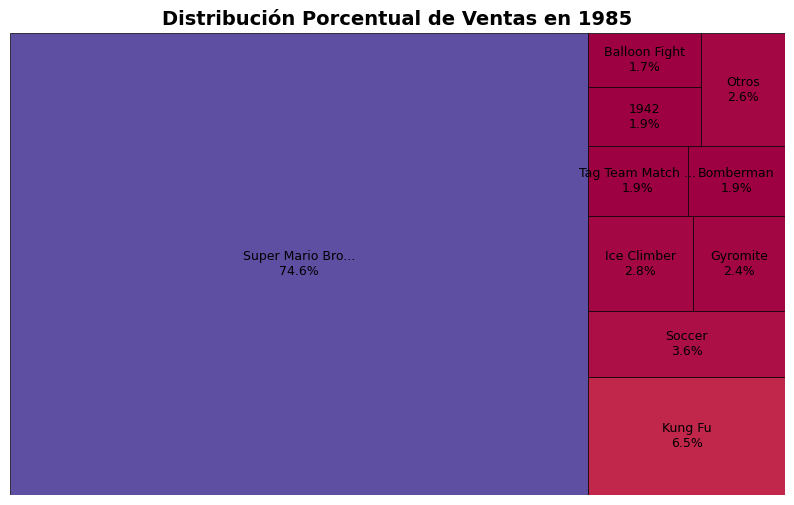

In [9]:

import pandas as pd
import matplotlib.pyplot as plt
import squarify
import seaborn as sns
import ipywidgets as widgets
from IPython.display import display, clear_output
import matplotlib.patches as patches

# Asegurar que 'Year_of_Release' sea de tipo entero y eliminar valores NaN
df_filtrado = df.dropna(subset=['Year_of_Release', 'Name', 'Global_Sales']).copy()
df_filtrado['Year_of_Release'] = df_filtrado['Year_of_Release'].astype(int)
df_filtrado['Name'] = df_filtrado['Name'].astype(str)

# Obtener lista de años únicos ordenados
years = sorted(df_filtrado["Year_of_Release"].unique())

# Widget para seleccionar el año
year_selector = widgets.Dropdown(
    options=years,
    value=years[0],
    description='Seleccionar Año:',
    disabled=False,
    layout=widgets.Layout(
        margin='20px 20px 10px 0px',
        width='200px',
        align_self='center'),
    style={'description_width': 'auto'}
)

# Función para acortar nombres largos
def recortar_nombre(nombre, max_len=15):
    return nombre if len(nombre) <= max_len else nombre[:max_len] + "..."

# Función para actualizar el treemap con Matplotlib
def actualizar_treemap(año):
    df_year = df_filtrado[df_filtrado["Year_of_Release"] == año][['Name', 'Global_Sales']].copy()

    if df_year.empty:
        print(f"No hay datos para el año {año}.")
        return

    # Ordenar los juegos por ventas y seleccionar los más vendidos
    df_year = df_year.sort_values(by="Global_Sales", ascending=False)
    total_ventas = df_year["Global_Sales"].sum()

    # Calcular porcentaje de cada videojuego
    df_year["Porcentaje"] = df_year["Global_Sales"] / total_ventas * 100

    # **Agrupar juegos con <2% en una categoría "Otros"**
    df_mayor_2 = df_year[df_year["Porcentaje"] >= 1.5].copy()
    df_menor_2 = df_year[df_year["Porcentaje"] < 1.5].copy()

    if not df_menor_2.empty:
        otros_ventas = df_menor_2["Global_Sales"].sum()
        otros_porcentaje = df_menor_2["Porcentaje"].sum()
        df_mayor_2 = pd.concat([df_mayor_2, pd.DataFrame({"Name": ["Otros"], "Global_Sales": [otros_ventas], "Porcentaje": [otros_porcentaje]})])

    # Limpiar salida para evitar acumulación de gráficos
    clear_output(wait=True)
    display(year_selector)

    # Crear la figura
    fig, ax = plt.subplots(figsize=(10, 6))

    # Definir colores con una paleta de Seaborn
    cmap = sns.color_palette("Spectral", as_cmap=True)

    # Normalizar valores para la escala de colores
    norm = plt.Normalize(df_mayor_2["Global_Sales"].min(), df_mayor_2["Global_Sales"].max())
    colors = [cmap(norm(value)) for value in df_mayor_2["Global_Sales"]]

    # Generar posiciones y tamaños con squarify
    rects = squarify.normalize_sizes(df_mayor_2["Global_Sales"], 100, 100)
    rects = squarify.squarify(rects, x=0, y=0, dx=100, dy=100)

    # Dibujar los rectángulos con Matplotlib
    for rect, color, (name, pct) in zip(rects, colors, zip(df_mayor_2["Name"], df_mayor_2["Porcentaje"])):
        # Dibujar el rectángulo
        ax.add_patch(patches.Rectangle(
            (rect['x'], rect['y']), rect['dx'], rect['dy'],
            facecolor=color, edgecolor='black', linewidth=0.5
        ))

        # Mostrar etiquetas solo para juegos con ≥2% de ventas
        ax.text(
            rect['x'] + rect['dx'] / 2, rect['y'] + rect['dy'] / 2,
            f"{recortar_nombre(name)}\n{pct:.1f}%",
            ha='center', va='center', fontsize=9, fontweight='normal', color='black'
        )

    # Configurar el gráfico
    ax.set_title(f"Distribución Porcentual de Ventas en {año}", fontsize=14, fontweight='bold')
    ax.set_xlim(0, 100)
    ax.set_ylim(0, 100)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis('off')  #

    # Mostrar la gráfica
    plt.show()

# Mostrar el selector de años
display(year_selector)

# Generar la gráfica inicial con el primer año seleccionado
actualizar_treemap(year_selector.value)

# Conectar el widget al cambio de año
year_selector.observe(lambda change: actualizar_treemap(change["new"]), names='value')




In [11]:
import plotly.graph_objects as go
import plotly.subplots as sp
import seaborn as sns
import ipywidgets as widgets
from IPython.display import display, clear_output

# Asegurar que 'Year_of_Release' sea de tipo entero y eliminar valores NaN
df_regiones = df.dropna(subset=['Year_of_Release', 'NA_Sales', 'EU_Sales', 'JP_Sales']).copy()
df_regiones['Year_of_Release'] = df_regiones['Year_of_Release'].astype(int)

df_generos = df.dropna(subset=['Year_of_Release', 'Genre', 'Global_Sales']).copy()
df_generos['Year_of_Release'] = df_generos['Year_of_Release'].astype(int)

# Filtrar solo los géneros de interés
generos_interes = ["Action", "Role-Playing", "Strategy", "Misc"]
df_generos = df_generos[df_generos["Genre"].isin(generos_interes)]

# Agrupar ventas por año
ventas_por_region = df_regiones.groupby("Year_of_Release")[["NA_Sales", "EU_Sales", "JP_Sales"]].sum().reset_index()
ventas_por_genero = df_generos.groupby(["Year_of_Release", "Genre"])["Global_Sales"].sum().reset_index()

# Widget para seleccionar el rango de años
year_range = widgets.IntRangeSlider(
    value=[ventas_por_region["Year_of_Release"].min(), ventas_por_region["Year_of_Release"].max()],
    min=ventas_por_region["Year_of_Release"].min(),
    max=ventas_por_region["Year_of_Release"].max(),
    step=1,
    description='Años:',
    continuous_update=False
)

# Función para actualizar ambas gráficas
def actualizar_graficos(year_range):
    start_year, end_year = year_range  # Obtener el rango de años seleccionado
    df_region_filtrado = ventas_por_region[(ventas_por_region["Year_of_Release"] >= start_year) &
                                           (ventas_por_region["Year_of_Release"] <= end_year)]

    df_genero_filtrado = ventas_por_genero[(ventas_por_genero["Year_of_Release"] >= start_year) &
                                           (ventas_por_genero["Year_of_Release"] <= end_year)]

    # Limpiar salida y mostrar el selector de rango
    clear_output(wait=True)

    # Definir colores de la paleta Spectral
    colores = sns.color_palette("Spectral", 7).as_hex()
    colores_regiones = {"NA_Sales": colores[0], "EU_Sales": colores[1], "JP_Sales": colores[2]}
    colores_generos = {"Action": colores[3], "Role-Playing": colores[4],
                       "Strategy": colores[5], "Misc": colores[6]}

    # Crear subplot con 2 filas y 1 columna
    fig = sp.make_subplots(rows=2, cols=1,
                           subplot_titles=("Tendencia de Ventas por Región",
                                           "Tendencia de Ventas por Género"))

    # Gráfica 1: Tendencia de ventas por región
    for region in ["NA_Sales", "EU_Sales", "JP_Sales"]:
        fig.add_trace(go.Scatter(
            x=df_region_filtrado["Year_of_Release"],
            y=df_region_filtrado[region],
            mode='lines+markers',
            name={"NA_Sales": "EE.UU", "EU_Sales": "Europa", "JP_Sales": "Japón"}[region],
            line=dict(color=colores_regiones[region], width=2),
            marker=dict(size=6),
            hovertemplate=f"<b>{region}</b><br>Año: %{{x}}<br>Ventas: %{{y:.2f}}M USD<extra></extra>"
        ), row=1, col=1)

    # Gráfica 2: Tendencia de ventas por género
    for genero in generos_interes:
        df_genero = df_genero_filtrado[df_genero_filtrado["Genre"] == genero]
        fig.add_trace(go.Scatter(
            x=df_genero["Year_of_Release"],
            y=df_genero["Global_Sales"],
            mode='lines+markers',
            name=genero,
            line=dict(color=colores_generos[genero], width=2),
            marker=dict(size=6),
            hovertemplate=f"<b>{genero}</b><br>Año: %{{x}}<br>Ventas: %{{y:.2f}}M USD<extra></extra>"
        ), row=2, col=1)

    # Personalizar diseño de la gráfica
    fig.update_layout(
        title=dict(
            text="Tendencia de Ventas en Regiones y Géneros",
            font=dict(family="serif", size=22, color="black", weight="bold"),  # Fuente y tamaño del título
            x=0.5  # Centrar el título
        ),
        plot_bgcolor='white',
        height=800,
        legend=dict(
            title_text="Categoría",
            font=dict(family="serif", size=14, color="black", weight="normal")  # Fuente y tamaño de la leyenda
        )
    )

    # Ajustes individuales para cada eje X e Y con fuentes personalizadas
    fig.update_xaxes(title="Año", tickfont=dict(family="serif", size=16, color="black", weight="bold"), row=1, col=1)
    fig.update_xaxes(title="Año", tickfont=dict(family="serif", size=16, color="black", weight="bold"), row=2, col=1)
    fig.update_yaxes(title="Ventas (Millones USD)", tickfont=dict(family="serif", size=16, color="black", weight="bold"), row=1, col=1)
    fig.update_yaxes(title="Ventas (Millones USD)", tickfont=dict(family="serif", size=16, color="black", weight="bold"), row=2, col=1)

    # Mostrar la gráfica
    fig.show()

# Mostrar el selector de años y la gráfica inicial
display(year_range)
actualizar_graficos(year_range.value)

# Conectar el widget al cambio de selección
year_range.observe(lambda change: actualizar_graficos(change["new"]), names='value')


El treemap permite analizar la distribución porcentual de las ventas en relación con los videojuegos lanzados en un año de interés. Por ejemplo, en 1980, se observa que los dos videojuegos dominantes representaron aproximadamente el 50% de las ventas totales de ese año. En contraste, para 1995, se lanzó una mayor variedad de videojuegos; sin embargo, la distribución de las ventas fue más equitativa entre los títulos. A pesar de ello, la mayoría del porcentaje de ventas corresponde al grupo "Otros", el cual agrupa los videojuegos con una participación inferior al 2%. Esta estrategia de visualización facilita la interpretación de la gráfica, proporcionando una visión más clara del panorama general.

Por otro lado, los gráficos de tendencia de ventas por región y por los cuatro géneros seleccionados muestran un comportamiento similar, alcanzando picos máximos alrededor de 2008 y 2009, seguidos de un descenso en las ventas. Este fenómeno podría estar asociado a la crisis económica global de 2008 y al impacto posterior de la pandemia, que afectó la industria de los videojuegos.

## Ejercicio 3

* ¿Cómo es la distribución porcentual de las ventas para los años 2000, 2005, 2010 y 2015?
* ¿Qué género aportó más porcentualmente en cada año y por cuánto valor?
* Compare 3 géneros en un rango de 4 años entre el 2000 al 2010 e indique ¿dónde presentó cada género mayor auge o ventas?

In [13]:
datos['percentaje_sales'] = (datos['Global_Sales']* 100 / datos['Global_Sales'].sum()) 
datos_anos = datos[datos['Year_of_Release'].isin([2000, 2005, 2010, 2015])]

porcentajes_por_ano = datos.groupby('Year_of_Release')['percentaje_sales'].sum().reset_index()

porcentajes_anos_seleccionados = datos_anos.groupby('Year_of_Release')['percentaje_sales'].sum().reset_index()

print(porcentajes_anos_seleccionados)

   Year_of_Release  percentaje_sales
0           2000.0          2.259789
1           2005.0          5.137832
2           2010.0          6.620741
3           2015.0          3.004944


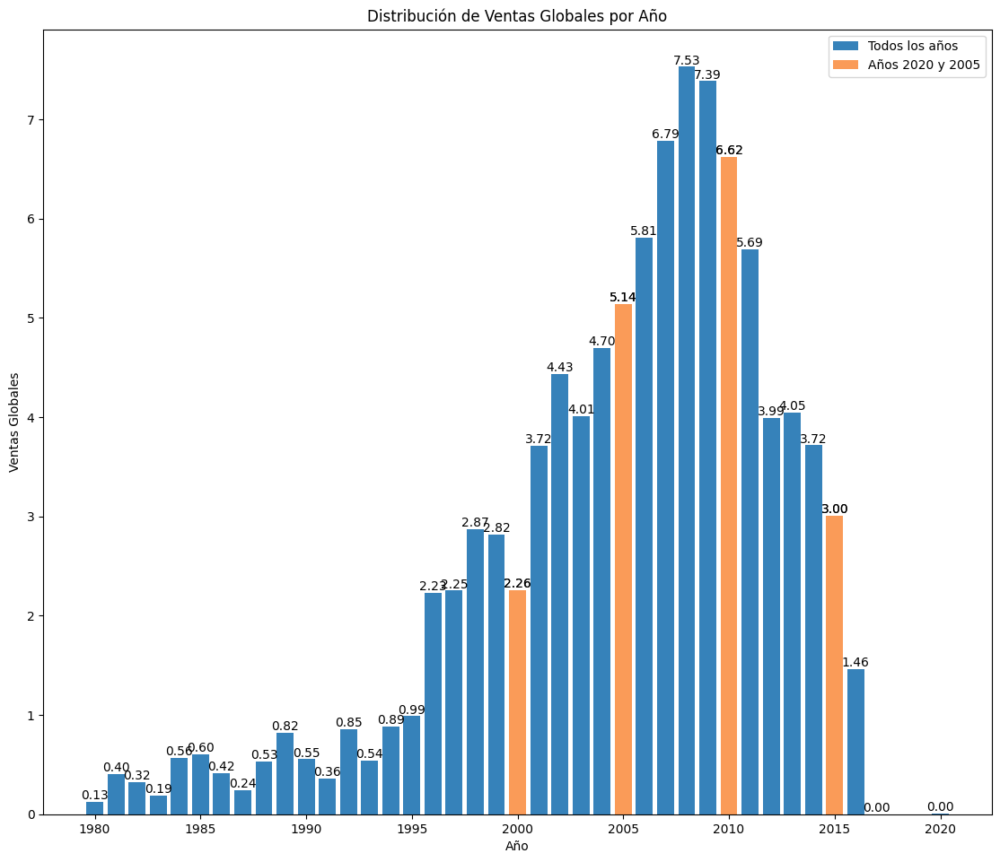

In [15]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(30, 25))
ax = fig.add_subplot(222)

# Barras para todos los años
bars1 = plt.bar(porcentajes_por_ano['Year_of_Release'], porcentajes_por_ano['percentaje_sales'], label='Todos los años', color='#3682BA')

# Barras para los años seleccionados (2020 y 2005)
bars2 = plt.bar(porcentajes_anos_seleccionados['Year_of_Release'], porcentajes_anos_seleccionados['percentaje_sales'], color='#FA9B58', label='Años 2020 y 2005')

# Agregar valores a las barras
for bar in bars1:
    height = bar.get_height()
    if height > 0:
        plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.2f}', 
                 ha='center', va='bottom', fontsize=10, color='black')

for bar in bars2:
    height = bar.get_height()
    if height > 0:
        plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.2f}', 
                 ha='center', va='bottom', fontsize=10, color='black')

plt.xlabel('Año')
plt.ylabel('Ventas Globales')
plt.title('Distribución de Ventas Globales por Año')
plt.legend()
plt.show()


In [18]:
datos_generos = datos.groupby('Genre')['Global_Sales'].sum().reset_index()
datos_generos['percentaje_sales'] = (datos_generos['Global_Sales']* 100 / datos_generos['Global_Sales'].sum())
datos_generos = datos_generos.sort_values(by='percentaje_sales', ascending=True)

datos_generos

,Genre,Global_Sales,percentaje_sales
11,Strategy,174.50,1.956743
1,Adventure,237.69,2.665320
5,Puzzle,243.02,2.725087
9,Simulation,390.42,4.377946
2,Fighting,447.48,5.017784
6,Racing,728.90,8.173467
3,Misc,803.18,9.006401
4,Platform,828.08,9.285615
7,Role-Playing,934.40,10.477827
8,Shooter,1052.94,11.807066


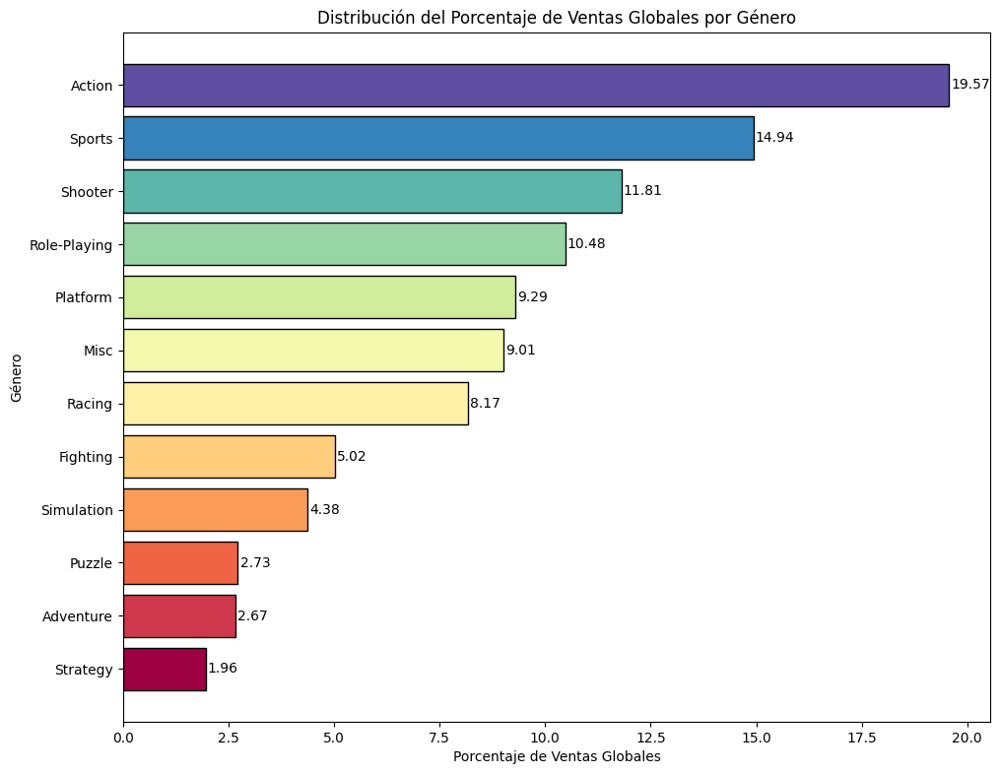

In [19]:
import matplotlib.pyplot as plt

colors = plt.cm.Spectral(np.linspace(0, 1, len(datos_generos)))

fig = plt.figure(figsize=(25, 20))
ax = fig.add_subplot(222)

# Barras con colores variados
bars1 = plt.barh(datos_generos['Genre'], datos_generos['percentaje_sales'], color=colors, label='Todos los géneros', edgecolor='black')

# Agregar valores a las barras
for bar in bars1:
    width = bar.get_width()  # Longitud de la barra en eje X
    if width > 0:
        plt.text(width + 0.05, bar.get_y() + bar.get_height()/2, f'{width:.2f}', 
                 ha='left', va='center', fontsize=10, color='black')

plt.ylabel('Género')
plt.xlabel('Porcentaje de Ventas Globales')
plt.title('Distribución del Porcentaje de Ventas Globales por Género')

plt.show()

In [20]:
datos_temporales = datos[['Year_of_Release', 'Global_Sales', 'Genre']]
datos_temporales_wide =  datos_temporales.pivot_table(index='Year_of_Release', columns='Genre', values='Global_Sales', aggfunc='sum').fillna(0).reset_index()

#datos_temporales_wide.columns.name = None
datos_temporales_wide

Genre,Year_of_Release,Action,Adventure,Fighting,Misc,Platform,Puzzle,Racing,Role-Playing,Shooter,Simulation,Sports,Strategy
0,1980.0,0.34,0.00,0.77,2.71,0.00,0.00,0.00,0.00,7.07,0.00,0.49,0.00
1,1981.0,14.84,0.00,0.00,0.00,6.93,2.24,0.48,0.00,10.04,0.45,0.79,0.00
2,1982.0,6.52,0.00,0.00,0.87,5.03,10.03,1.57,0.00,3.79,0.00,1.05,0.00
3,1983.0,2.86,0.40,0.00,2.14,6.93,0.78,0.00,0.00,0.48,0.00,3.20,0.00
4,1984.0,1.85,0.00,0.00,1.45,0.69,3.14,5.95,0.00,31.10,0.00,6.18,0.00
5,1985.0,3.52,0.00,1.05,0.00,43.17,3.21,0.00,0.00,1.00,0.03,1.96,0.00
6,1986.0,13.74,0.00,0.00,0.00,9.39,0.00,1.96,2.52,3.89,0.00,5.57,0.00
7,1987.0,1.12,4.38,5.42,0.00,1.74,0.00,0.00,4.65,0.71,0.00,3.72,0.00
8,1988.0,1.75,0.00,0.00,0.00,27.73,5.58,2.14,5.88,0.51,0.03,3.60,0.00
9,1989.0,4.64,0.00,0.00,1.28,20.66,37.75,0.00,2.20,1.20,0.00,5.72,0.00


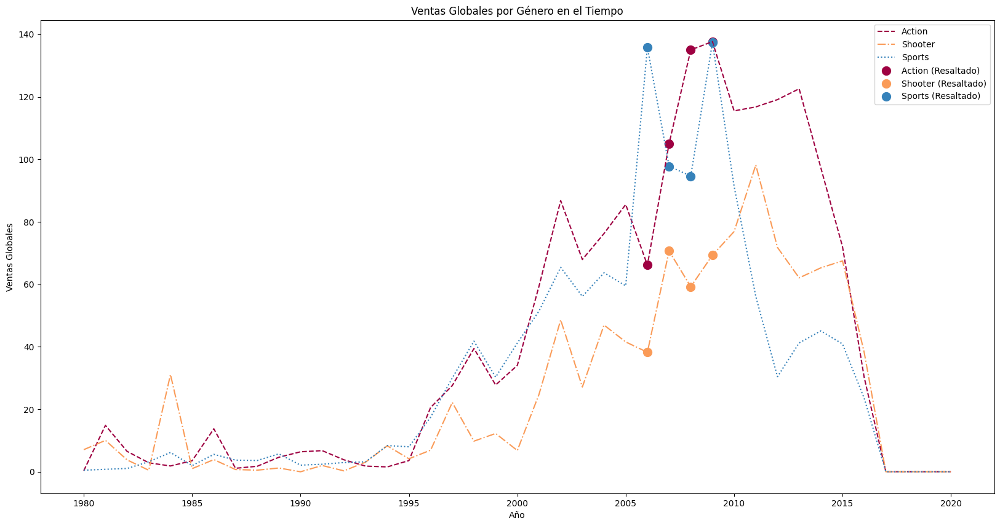

In [22]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(20, 10))

# Trazar las líneas correctamente usando plt.plot()
plt.plot(datos_temporales_wide['Year_of_Release'], datos_temporales_wide['Action'], label='Action', color='#9E0142', linestyle='--')
plt.plot(datos_temporales_wide['Year_of_Release'], datos_temporales_wide['Shooter'], label='Shooter', color='#FA9B58', linestyle='-.')
plt.plot(datos_temporales_wide['Year_of_Release'], datos_temporales_wide['Sports'], label='Sports', color='#3682BA', linestyle=':')

# Años a resaltar
years_to_highlight = [2006, 2007, 2008, 2009]

# Filtrar los datos para esos años
highlight_data = datos_temporales_wide[datos_temporales_wide['Year_of_Release'].isin(years_to_highlight)]

# Agregar puntos destacados con plt.scatter()
plt.scatter(highlight_data['Year_of_Release'], highlight_data['Action'], color='#9E0142', s=100, label='Action (Resaltado)')
plt.scatter(highlight_data['Year_of_Release'], highlight_data['Shooter'], color='#FA9B58', s=100, label='Shooter (Resaltado)')
plt.scatter(highlight_data['Year_of_Release'], highlight_data['Sports'], color='#3682BA', s=100, label='Sports (Resaltado)')


plt.xlabel('Año')
plt.ylabel('Ventas Globales')
plt.title('Ventas Globales por Género en el Tiempo')
plt.legend()
plt.show()


## Ejercicio 4

* Cómo es la distribución percentil? ¿dónde presenta mayor agrupamiento de los datos?
* En una vista superpuesta indique o compare los scores para el género escogido. ¿Hay cercanía entre las valoraciones de los usuarios y la de los críticos?
* ¿Cuál es el valor del score aproximadamente donde un videojuego alcanzó el mayor número de ventas?
* ¿Cuál es la distribución de la correlación para el género escogido?
* ¿Qué relación existe entre los scores de los jugadores y de la crítica para el género escogido?

In [107]:

Action = datos[datos.Genre == 'Action']
Action['User_Score'] = Action['User_Score'].replace('tbd', np.nan)
Action['User_Score'] = pd.to_numeric(Action['User_Score'])
Action['User_Score'] = Action['User_Score']*10


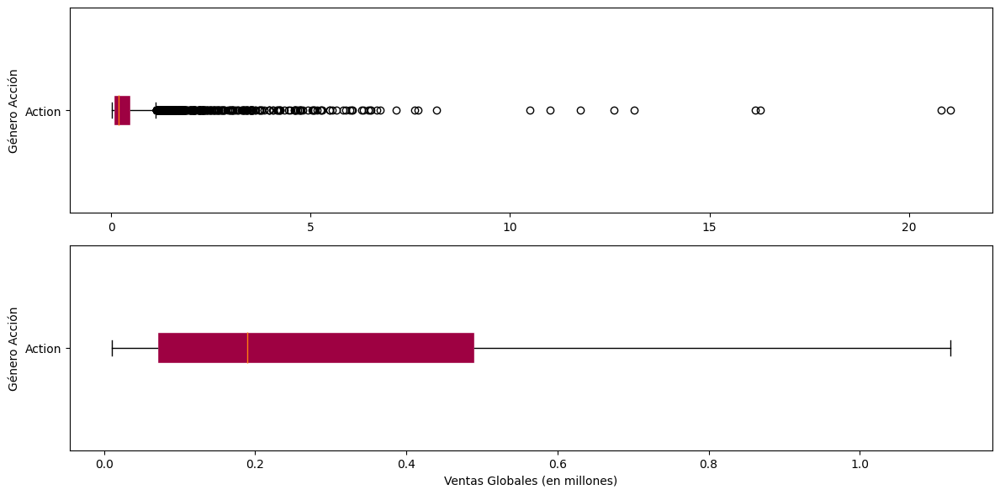

In [97]:
fig = plt.figure(figsize=(12, 6))


fig1 = fig.add_subplot(2,1,1)
fig1.boxplot([Action['Global_Sales']], tick_labels=['Action'], 
            patch_artist=True, 
            boxprops=dict(facecolor='#9E0142', color='white'), 
            vert=False, 
            showfliers=True)

fig1.set_ylabel('Género Acción')



fig2 = fig.add_subplot(2,1,2)
fig2.boxplot([Action['Global_Sales']], tick_labels=['Action'], 
            patch_artist=True, 
            boxprops=dict(facecolor='#9E0142', color='white'), 
            vert=False, 
            showfliers=False)

fig2.set_ylabel('Género Acción')
fig2.set_xlabel('Ventas Globales (en millones)')


plt.tight_layout()  # Ajustar el espacio entre los gráficos
plt.show()


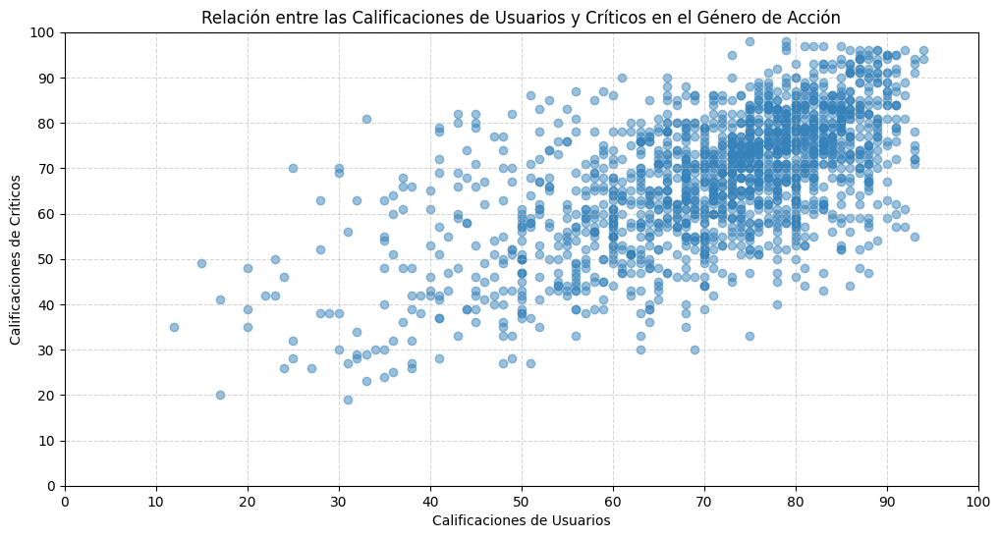

In [61]:

fig = plt.figure(figsize=(12, 6))

plt.scatter(Action['User_Score'], Action['Critic_Score'], color='#3682BA', alpha=0.5)

plt.xlabel('Calificaciones de Usuarios')
plt.ylabel('Calificaciones de Críticos')
plt.title("Relación entre las Calificaciones de Usuarios y Críticos en el Género de Acción")

# Definir los intervalos de 10 en 10
plt.xticks(np.arange(0, 110, 10))  # Escala de 0 a 100 con pasos de 10
plt.yticks(np.arange(0, 110, 10))  # Escala de 0 a 100 con pasos de 10

# Ajustar los límites de los ejes para asegurarnos de que cubran todo el rango
plt.xlim(0, 100)
plt.ylim(0, 100)

plt.grid(True, linestyle="--", alpha=0.5)  # Agregar una cuadrícula opcional

plt.show()


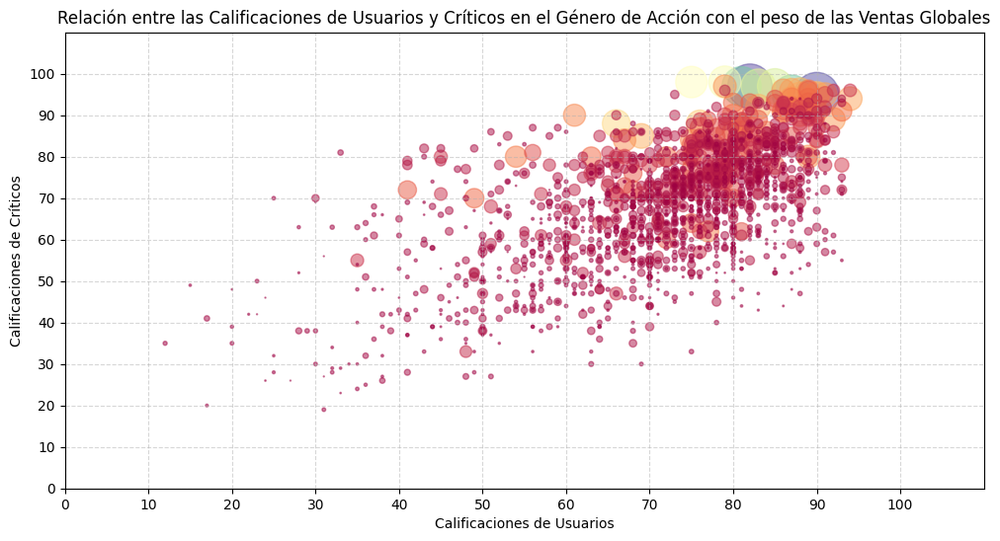

In [104]:

fig = plt.figure(figsize=(12, 6))

plt.scatter(Action['User_Score'], Action['Critic_Score'], s=Action['Global_Sales']*50, c=Action['Global_Sales'],  cmap = 'Spectral', alpha=0.5)

plt.xlabel('Calificaciones de Usuarios')
plt.ylabel('Calificaciones de Críticos')
plt.title("Relación entre las Calificaciones de Usuarios y Críticos en el Género de Acción con el peso de las Ventas Globales")

# Definir los intervalos de 10 en 10
plt.xticks(np.arange(0, 110, 10))  # Escala de 0 a 100 con pasos de 10
plt.yticks(np.arange(0, 110, 10))  # Escala de 0 a 100 con pasos de 10

# Ajustar los límites de los ejes para asegurarnos de que cubran todo el rango
plt.xlim(0, 110)
plt.ylim(0, 110)

plt.grid(True, linestyle="--", alpha=0.5)  # Agregar una cuadrícula opcional

plt.show()

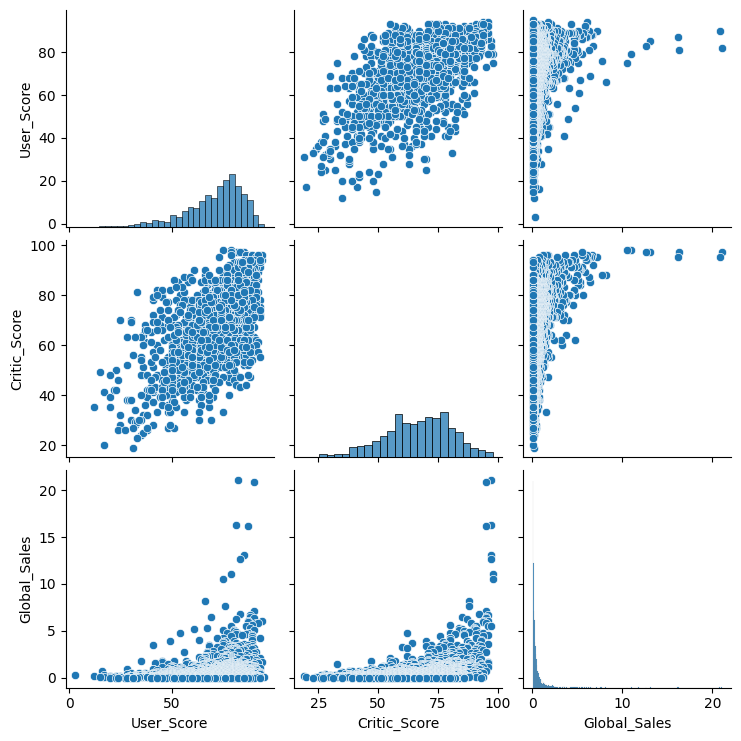

In [106]:
action_selectes = Action[['User_Score', 'Critic_Score', 'Global_Sales']]

# Basic correlogram
sns.pairplot(action_selectes)
plt.show()

El rango de ventas globales con menor dispersión y concentración de los datos estuvo entre los valores de 0.01 millones de dólares y 0.08 millones de dólares que concentran el primer cuartil (Q1). El rango con mayor dispersión de los datos de valores de ventas globales se observó para el Q3-Q4, desde los 0.5 a los 1.2 millones de dólares.

La relación que se encontró entre los *scores* de los usuarios y los *scores* de la crítica fue directamente proporcional, y por lo general cuando la crítica le da buena calificación a los juego de acción, los usuarios tambien los califican de la misma manera.

Cuando se analiza como se relacionan los *scores* tanto de la crítica cómo de los usuarios con las ventas globales se puede observar que esta relación es más bien de tipo logarítmica, dónde los *scores* medios mantienen ventas más bien bajas y son los valores de scores más altos los que disparan las ventas de manera general.

## Ejercicio Bonus

* ¿Qué plataforma obtuvo la mayor cantidad de ventas?
* ¿Cuántos juegos por año se lanzaron por plataforma?
* ¿Cuál es el juego más valorado por la crítica? ¿Cuál por los usuarios?
* ¿Cuántos juegos tiene cada productor o publicador de videojuegos?

In [91]:
import pandas as pd
import plotly.express as px

# Eliminación de NaN
df_clean = df.dropna(subset=["Platform", "Global_Sales"])
df_clean["Global_Sales"] = pd.to_numeric(df_clean["Global_Sales"], errors="coerce")

# Agrupar ventas por plataforma
ventas_por_plataforma = df_clean.groupby("Platform")["Global_Sales"].sum().reset_index()

# Categoría "Otras" para las plataformas con ventas inferiores a 100M
ventas_por_plataforma["Platform"] = ventas_por_plataforma.apply(
    lambda row: "Otras" if row["Global_Sales"] < 100 else row["Platform"], axis=1
)

# Reagrupamiento de las ventas
ventas_por_plataforma = ventas_por_plataforma.groupby("Platform")["Global_Sales"].sum().reset_index()

# Ordenar de menor a mayor para que la barra más grande quede arriba
ventas_por_plataforma = ventas_por_plataforma.sort_values(by="Global_Sales", ascending=True)

# Gráfico de barras
fig = px.bar(
    ventas_por_plataforma,
    x="Global_Sales",
    y="Platform",
    orientation="h",
    text_auto=".2f",
    title="Ventas Totales por Plataforma (Plataformas < 100M en ventas agrupadas como 'Otras')",
    labels={"Global_Sales": "Ventas Globales (Millones USD)", "Platform": "Plataforma"},
    color="Global_Sales",
    color_continuous_scale="Spectral"
)

# Personalizar texto y diseño
fig.update_layout(
    plot_bgcolor="white",  # Fondo blanco
    xaxis=dict(
        showgrid=False,
        tickfont=dict(size=14, family="serif", color="black")
    ),
    yaxis=dict(
        showgrid=False,
        tickfont=dict(size=14, family="serif", color="black")
    ),
    title=dict(  # Corrección aquí: "title" en vez de "tittle"
        text="Ventas Totales por Plataforma (Plataformas < 100M en ventas agrupadas como 'Otras')",
        font=dict(size=22, family="serif", color="black", weight="bold")
    )
)

fig.show()


In [87]:
import plotly.express as px
import pandas as pd

# Eliminación de NAN
df_clean = df.dropna(subset=["Year_of_Release", "Platform"])
df_clean["Year_of_Release"] = df_clean["Year_of_Release"].astype(int)

# Agrupacion de cantidad de juegos por año y plataforma
juegos_por_año = df_clean.groupby(["Year_of_Release", "Platform"]).size().reset_index(name="Total_Juegos")

# Convertir a matriz
heatmap_data = juegos_por_año.pivot(index="Platform", columns="Year_of_Release", values="Total_Juegos").fillna(0)

# Crear Heatmap
fig = px.imshow(
    heatmap_data,
    labels=dict(x="Año", y="Plataforma", color="Cantidad de Juegos"),
    title="Juegos Lanzados por Año y Plataforma",
    color_continuous_scale=[
        [0, 'white'],  # Blanco cuando el valor es cero
        [0.01, '#9E0142'], # rojo oscuro para valores bajos
        [0.1, '#D53E4F'],  # rojo claro para valores bajos
        [0.3, '#F46D43'],  # Valores intermedios en naranja
        [0.5, '#FEE08B'],  # Valores intermedios en amarillo
        [0.6, '#E6F598'],  # Valores intermedios en verde amarillo
        [0.8, '#ABDDA4'],  # verde Valores intermedios en naranja
        [0.9, '#3288BD'],  # Valores más altos en azul
        [1, '#5E4FA2']  # Valores más altos en azul
    ]
)

# Personalizar texto
fig.update_layout(
    plot_bgcolor="white",
    xaxis=dict(
        showgrid=True, gridcolor="lightgray",
        tickfont=dict(size=14, family="serif", color="black")
        
    ),
    yaxis=dict(
        showgrid=True, gridcolor="lightgray",
        tickfont=dict(size=14, family="serif", color="black")
    ),
    title=dict(
        font=dict(size=22, family="serif", color="black", weight="bold") ,
        x=0.5
    )
)

fig.show()





In [88]:
import plotly.graph_objects as go
import pandas as pd

# Quitar valores NaN y asegurar formato correcto
df_clean = df.dropna(subset=["Critic_Score", "User_Score", "Global_Sales"]).copy()

# Conversion a formato numerico
df_clean.loc[:, "Critic_Score"] = pd.to_numeric(df_clean["Critic_Score"], errors="coerce")
df_clean.loc[:, "User_Score"] = pd.to_numeric(df_clean["User_Score"], errors="coerce")

# Normalización de los puntajes
df_clean.loc[:, "Critic_Score_Norm"] = df_clean["Critic_Score"] / 10  # Escalar a 0-10

# Crear el Scatter plot
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=df_clean["Critic_Score_Norm"],
    y=df_clean["User_Score"],
    mode='markers',
    marker=dict(
        size=df_clean["Global_Sales"] * 2,  # Tamaño según ventas globales
        color=df_clean["Global_Sales"],  # Color según ventas
        colorscale="Spectral",
        showscale=True
    ),
    text=df_clean["Name"],
    name="Valoraciones Críticos vs Usuarios",
    hovertemplate="<b>%{text}</b><br>Críticos: %{x:.1f}<br>Usuarios: %{y:.1f}<br>Ventas: %{marker.color:.2f}M<extra></extra>"
))

# Personalización de texto
fig.update_layout(
    title=dict(
        text="Relación entre Puntuaciones de Críticos y Usuarios",
        x=0.5,  # Centrar título
        font=dict(size=22, family="serif", color="black", weight="bold")
    ),
    xaxis=dict(
        title="Puntuación de Críticos (Normalizada 0-10)",
        showgrid=False,  # Quitar grilla
        tickfont=dict(size=14, family="serif", color="black")
    ),
    yaxis=dict(
        title="Puntuación de Usuarios",
        showgrid=False,  # Quitar grilla
        tickfont=dict(size=14, family="serif", color="black")
    ),
    plot_bgcolor="white"
)

fig.show()


In [89]:
import plotly.express as px
import pandas as pd

# limpieza de datos: quitar valores nan y asegurar formato correcto
df_clean = df.dropna(subset=["Publisher"]).copy()

# contar el número de juegos por publicador
publisher_counts = df_clean["Publisher"].value_counts().reset_index()
publisher_counts.columns = ["Publisher", "Total_Juegos"]

# agrupar los publicadores con menos de 50 juegos en "otros"
publisher_counts.loc[publisher_counts["Total_Juegos"] < 50, "Publisher"] = "Otros"

# volver a contar después de agrupar
publisher_counts = publisher_counts.groupby("Publisher")["Total_Juegos"].sum().reset_index()

# crear treemap interactivo
fig = px.treemap(
    publisher_counts,
    path=["Publisher"],  # estructura jerárquica del treemap
    values="Total_Juegos",
    title="Distribución de Juegos por Publicador (Menor a 50 Agrupados en 'Otros')",
    color="Total_Juegos",
    color_continuous_scale="Spectral",
)

# personalización del diseño
fig.update_layout(
    title=dict(
        text="Distribución de Juegos por Publicador (Menor a 50 Agrupados en 'Otros')",
        x=0.5,  # centrar título
        font=dict(size=22, family="serif", color="black", weight="bold"),
    ),
    plot_bgcolor="white",
)

# modificar etiquetas al pasar el cursor
fig.update_traces(
    hovertemplate="<b>%{label}</b><br>Total de Juegos: %{value}<extra></extra>",
    textfont=dict(size=14, family="serif", color="black")  # modificar fuente de etiquetas
)

fig.show()


In [96]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output

# Cargar y limpiar los datos
df = datos.dropna(subset=['Year_of_Release']).copy()
df['Year_of_Release'] = df['Year_of_Release'].astype(int)

# Filtrar columnas necesarias
df1 = df[['Name', 'Year_of_Release', 'Global_Sales']].copy()

# Obtener años únicos ordenados
years = sorted(df1["Year_of_Release"].unique())

# Crear la aplicación Dash
app = Dash(__name__)

# **DISEÑO DE LA INTERFAZ**
app.layout = html.Div([
    html.H1("Análisis de Ventas de Videojuegos", style={'textAlign': 'center'}),

    # **Contenedor para selector de año + cuadros de texto**
    html.Div([
        # Selector de año
        html.Div([
            html.Label("Seleccionar Año:", style={'fontSize': '18px', 'fontWeight': 'bold'}),
            dcc.Dropdown(
                id='year-selector',
                options=[{'label': str(year), 'value': year} for year in years],
                value=years[0],  
                clearable=False,
                style={
                    'width': '150px',  
                    'fontSize': '16px',
                    'padding': '5px'
                }
            ),
        ], style={'margin-right': '30px'}),  # Espacio entre el selector y los cuadros de texto

        # Cuadros de texto alineados a la derecha
        html.Div([
            html.Label("Ventas Top 10 (Millones USD):", style={'fontSize': '16px', 'fontWeight': 'bold'}),
            html.Div(id='ventas-top10', style={'fontSize': '20px', 'fontWeight': 'bold', 'margin-bottom': '10px'}),

            html.Label("Ventas Resto de Juegos (Millones USD):", style={'fontSize': '16px', 'fontWeight': 'bold'}),
            html.Div(id='ventas-resto', style={'fontSize': '20px', 'fontWeight': 'bold'})
        ])
       
    ], style={'display': 'flex', 'alignItems': 'center', 'margin-bottom': '20px'}),  # Alinear en fila

    # **Gráficos**
    dcc.Graph(id='bar-chart'),
    dcc.Graph(id='pie-chart')
])

# **CALLBACK PARA ACTUALIZAR LOS GRÁFICOS Y CUADROS DE TEXTO**
@app.callback(
    [Output('bar-chart', 'figure'),
     Output('pie-chart', 'figure'),
     Output('ventas-top10', 'children'),
     Output('ventas-resto', 'children')],
    [Input('year-selector', 'value')]
)
def actualizar_graficos(año):
    df_filtrado = df1[df1["Year_of_Release"] == año].copy()

    # Obtener el Top 10 juegos más vendidos, asegurando orden descendente
    top_10 = df_filtrado.nlargest(10, "Global_Sales").sort_values(by="Global_Sales", ascending=True)

    # Sumar ventas del Top 10 y del resto de juegos
    total_top10 = round(top_10["Global_Sales"].sum(), 2)
    total_resto = round(df_filtrado["Global_Sales"].sum() - total_top10, 2)

    # **GRÁFICO DE BARRAS**
    fig_bar = px.bar(
        top_10,
        x="Global_Sales",
        y="Name",
        orientation='h',
        title=f"Top 10 Juegos Más Vendidos en {año}",
        color="Global_Sales",
        color_continuous_scale="Spectral"
    )

    fig_bar.update_traces(marker=dict(line=dict(color="black", width=1)))

    # **GRÁFICO DE PIE CHART**
    fig_pie = px.pie(
        names=["Top 10", "Resto de Juegos"],
        values=[total_top10, total_resto],
        title=f"Distribución de Ventas en {año}",
        color=["Top 10", "Resto de Juegos"],
        color_discrete_sequence=["#1f77b4", "#ff7f0e"]
    )

    return fig_bar, fig_pie, f"{total_top10} M USD", f"{total_resto} M USD"


# **INICIAR LA APLICACIÓN**
if __name__ == '__main__':
    app.run_server(debug=True, use_reloader=False)



El análisis de ventas por plataforma en el grafico de barras, muestra que PS2 es la consola más vendida de la historia, superando los 1,200 millones de USD. Otras plataformas destacadas incluyen X360, PS3, Wii y DS, lo que evidencia el dominio de Sony y Microsoft en la industria. Las plataformas con ventas inferiores a 100 millones se agruparon en "Otras", reflejando un mercado donde pocas consolas concentran la mayoría de las ventas.

El heatmap de lanzamientos muestra con tonos azules los valores más altos, evidenciando un auge en la industria entre 2005 y 2010, con un alto número de juegos lanzados para PS2, Wii y X360. A partir de 2015, la cantidad de títulos disminuye (tonos rojos), lo que podría estar relacionado con la transición hacia modelos digitales y servicios de suscripción y la pandemia.

En cuanto al diagrama de dispersión, se muestra la relación entre las puntuaciones de críticos y usuarios, se observa una correlación positiva: los juegos mejor valorados por la crítica suelen recibir buenas calificaciones de los jugadores. Sin embargo, hay excepciones donde títulos con altas puntuaciones de críticos son mal recibidos por los usuarios, posiblemente por diferencias en expectativas o controversias. Además, los juegos con mayores ventas no siempre son los mejor puntuados, lo que indica que el éxito comercial no depende exclusivamente de la valoración del público.

El análisis de publicadores a traves del treemap, muestra que la industria está dominada por Electronic Arts, Ubisoft y Activision, con un alto volumen de juegos lanzados. Nintendo, Sega y Capcom también destacan con catálogos extensos, mientras que un gran número de estudios más pequeños se agrupan en la categoría "Otros". Esto confirma que, aunque existen muchas empresas en el sector, la producción de videojuegos está concentrada en unas pocas grandes compañías.